figure = 66.66
bottle = 62.96
pen = 54.54

In [15]:
import sys
sys.path.append(r"C:\Users\49174\anaconda3\envs\praktikum\Lib\site-packages")
import torch
import numpy as np
from dataset_jacquard_samples import JacquardSamples
from utils import get_transform, get_inv_transform
from bce_model import BCEGraspTransformer
from utils_train import create_correct_false_points
import random
from pytorch_lightning.loggers import TensorBoardLogger
import matplotlib.pyplot as plt
from metrics_utils import * 
from infer_utils import * 

In [16]:
IMAGE_SIZE = 1120 
PATCH_DIM = IMAGE_SIZE //14
IDX = 3 #id of the object in the category

In [17]:
split_train = r"Bottle_train/"
split_test = r"Bottle_test/"

## Init the Valid Input Point Model 

In [18]:
args_infer = {
    "model_path" : "runs/bottle_1_single_left_right.ckpt",
    "device" : "cuda",
    "img_size" : IMAGE_SIZE
}

In [19]:
device = torch.device(args_infer["device"]) if torch.cuda.is_available() else torch.device("cpu")
image_transform = get_transform()
inv_transform = get_inv_transform()
model = BCEGraspTransformer(img_size=IMAGE_SIZE,int_dim=256,output_dim=128,input_cls=3)
dataset_train = JacquardSamples(dataset_root= split_train ,image_transform=image_transform, num_targets=5, overfit=False,
                              img_size=args_infer["img_size"], idx=4)
dataset = JacquardSamples(dataset_root= split_test ,image_transform=image_transform, num_targets=5, overfit=False,
                              img_size=args_infer["img_size"], idx=7)
model.load_state_dict(torch.load(args_infer["model_path"]))
model = model.to(device)

## Init the Second Point Model 

In [21]:
args_infer_single = {
    "model_path" : "runs/bottle_1_double_sampling.ckpt",
    "device" : "cuda",
    "img_size" : 1120
}


In [23]:
device = torch.device(args_infer["device"])
image_transform = get_transform()
inv_transform = get_inv_transform()
model_single = BCEGraspTransformer(img_size=args_infer_single["img_size"],int_dim=256,output_dim=32,input_cls=3)
model_single.load_state_dict(torch.load(args_infer_single["model_path"]))
model_single = model_single.to(device)

In [24]:
constrain_mode = True
TOPK = True
topk_grasps = 1
topk_input = 50

In [25]:
max_dist =0
min_dist = 999999
for i in range(len(dataset_train)):
    data = dataset_train[i]
    img = data["img"].to(device)
    img = torch.permute(img, (0, 2, 1))
    mask = data["mask"].sum().sqrt()
    all_points = torch.tensor(data["points_grasp"]//14)
    dif = (all_points[:, 0, :] - all_points[:, 1, :]).type(torch.float32).norm(p=2, dim=1)
    dif_n = (dif/mask).unsqueeze(1)
    if max_dist < dif_n.max():
        max_dist = dif_n.max()
    if min_dist > dif_n.min() and dif_n.min()>0:
        min_dist = dif_n.min()
if min_dist < 0.01:
    min_dist = 0.01

/tmp/ipykernel_99663/3396165159.py:8: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  all_points = torch.tensor(data["points_grasp"]//14)


In [26]:
print(min_dist)

tensor(0.0167)


In [27]:
print(len(dataset))

27


### Loop over the data and get the metrics

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Accuracy is 100.0 %
Object accuracy is 100.0


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Accuracy is 100.0 %
Object accuracy is 100.0


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Accuracy is 0.0 %
Object accuracy is 66.66666666666667


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Accuracy is 0.0 %
Object accuracy is 50.0


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Accuracy is 100.0 %
Object accuracy is 60.0


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Accuracy is 100.0 %
Object accuracy is 66.66666666666667


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Accuracy is 0.0 %
Object accuracy is 57.142857142857146


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Accuracy is 100.0 %
Object accuracy is 62.5


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Accuracy is 100.0 %
Object accuracy is 66.66666666666667


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Accuracy is 100.0 %
Object accuracy is 70.0


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Accuracy is 0.0 %
Object accuracy is 63.63636363636363


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Accuracy is 100.0 %
Object accuracy is 66.66666666666667


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Accuracy is 100.0 %
Object accuracy is 69.23076923076923


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Accuracy is 0.0 %
Object accuracy is 64.28571428571429


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Accuracy is 100.0 %
Object accuracy is 66.66666666666667


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Accuracy is 100.0 %
Object accuracy is 68.75


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Accuracy is 100.0 %
Object accuracy is 70.58823529411765


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Accuracy is 100.0 %
Object accuracy is 72.22222222222223


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Accuracy is 100.0 %
Object accuracy is 73.6842105263158


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Accuracy is 100.0 %
Object accuracy is 75.0


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Accuracy is 100.0 %
Object accuracy is 76.19047619047619


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Accuracy is 100.0 %
Object accuracy is 77.27272727272727


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Accuracy is 100.0 %
Object accuracy is 78.26086956521739


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Accuracy is 100.0 %
Object accuracy is 79.16666666666667


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Accuracy is 100.0 %
Object accuracy is 80.0


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Accuracy is 100.0 %
Object accuracy is 80.76923076923077


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Accuracy is 100.0 %
Object accuracy is 81.48148148148148


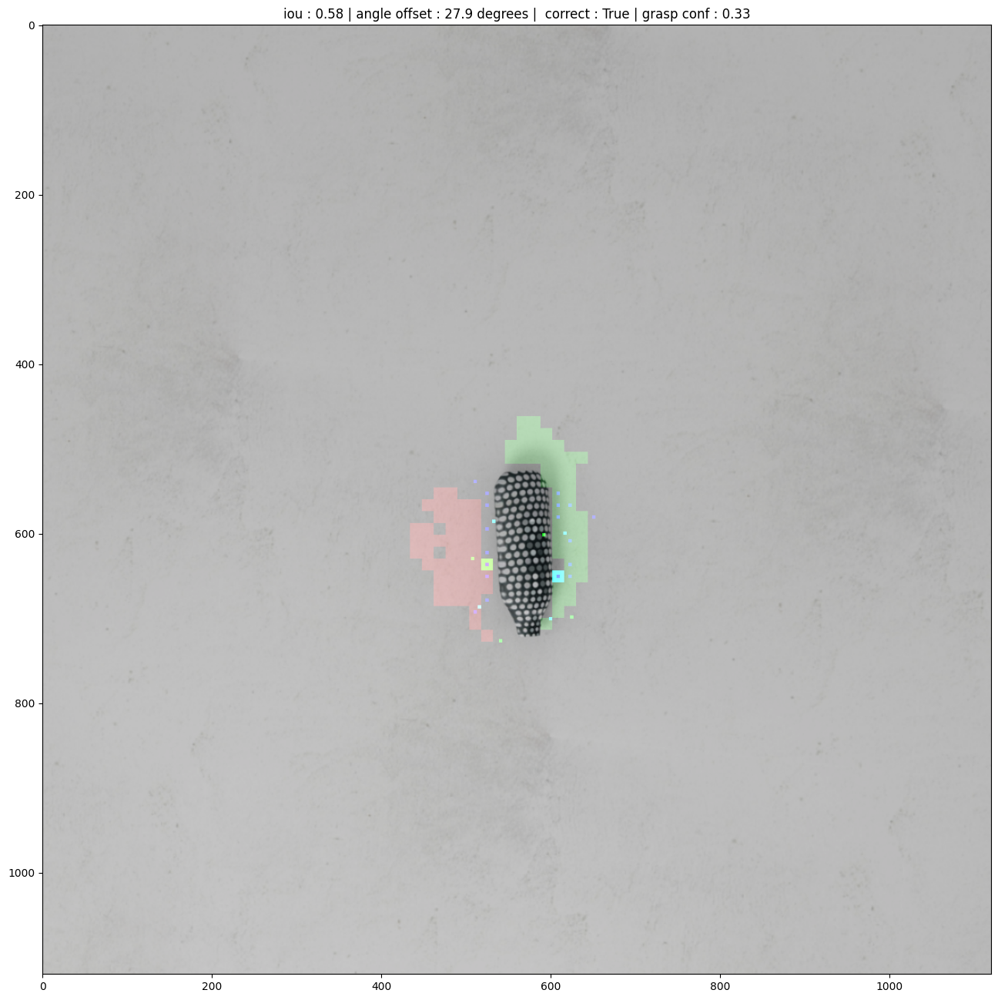

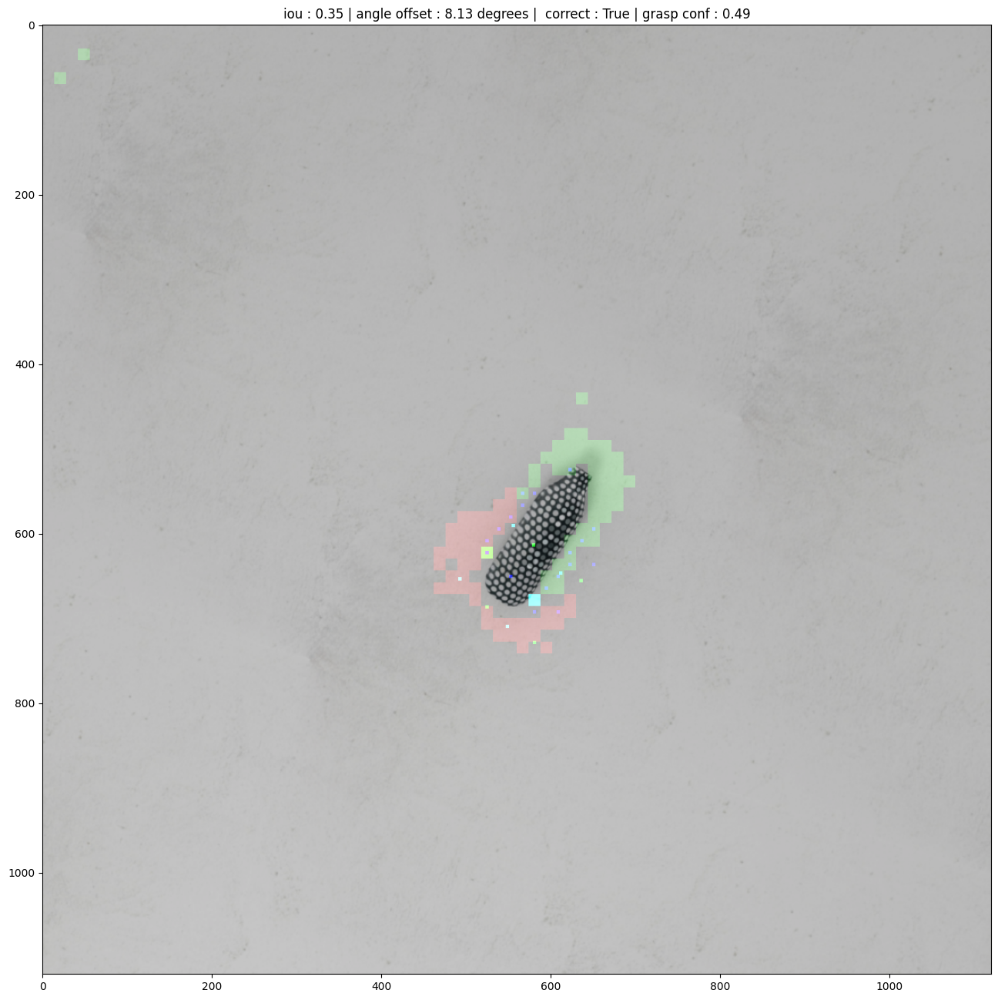

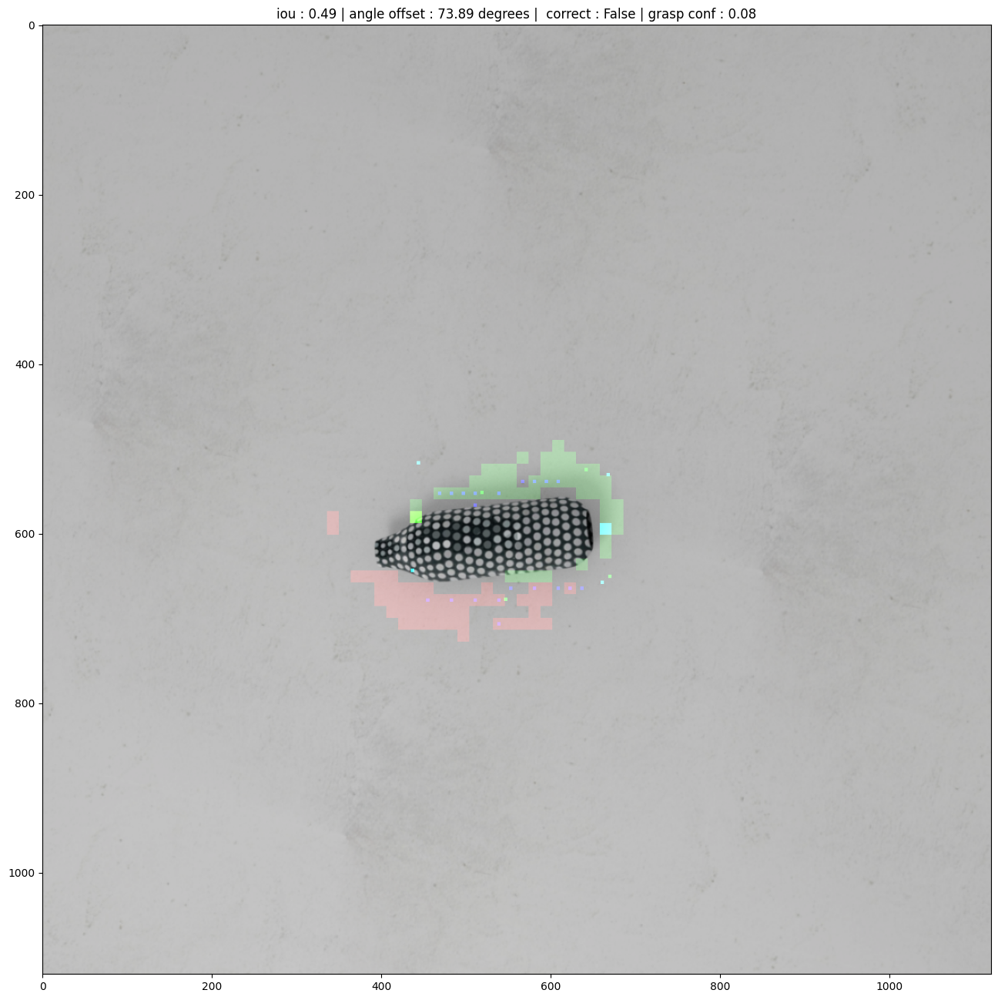

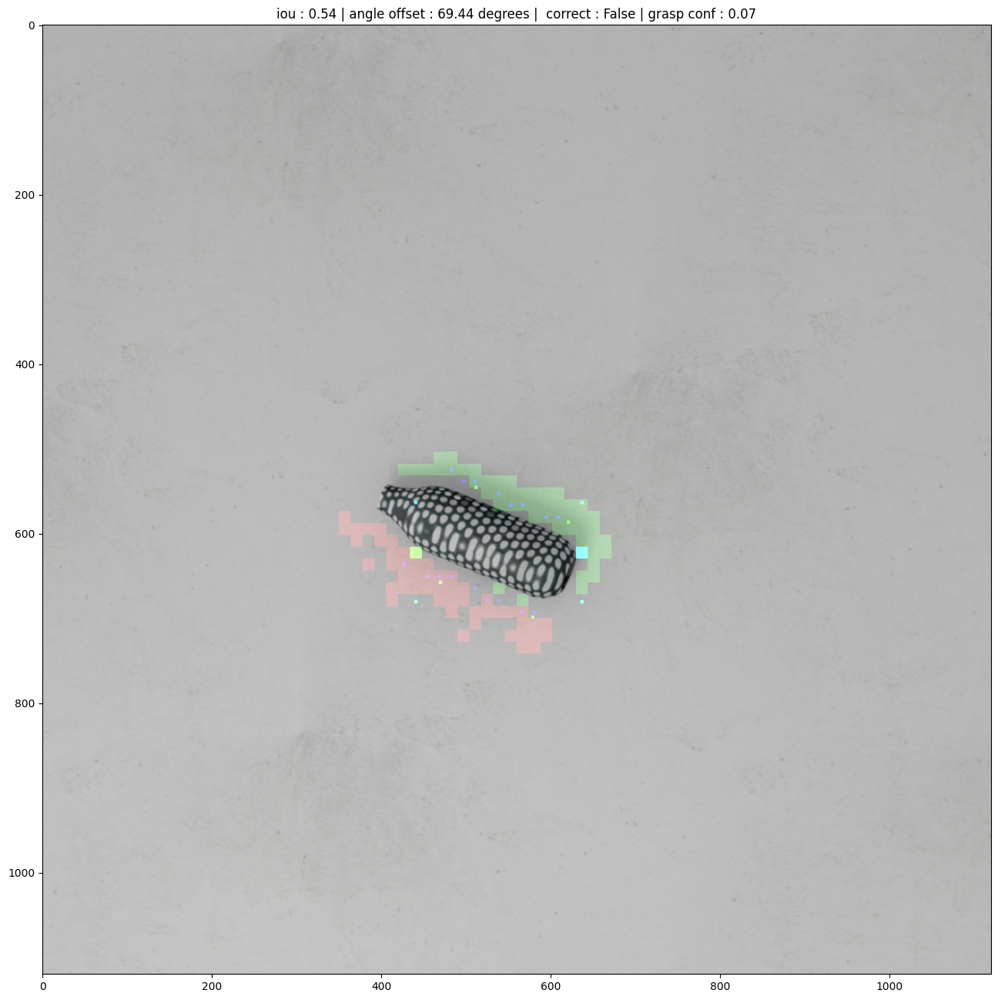

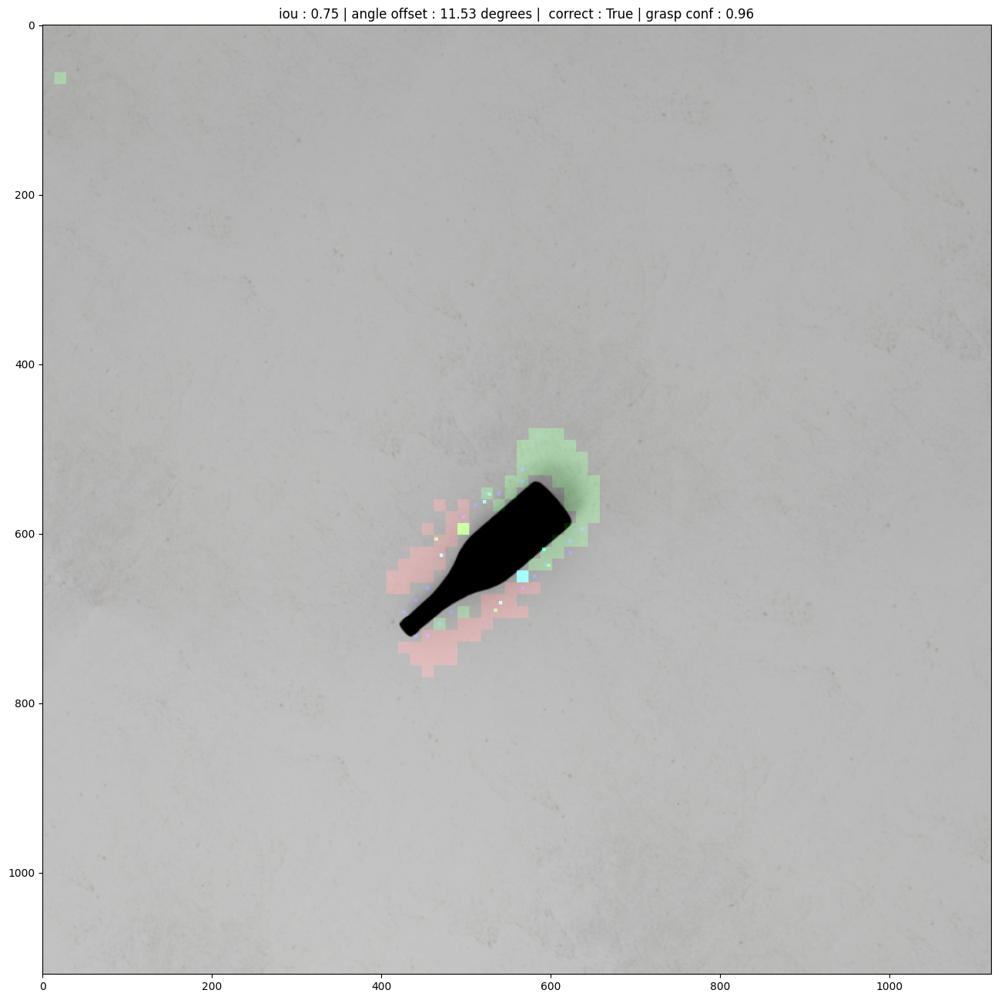

...

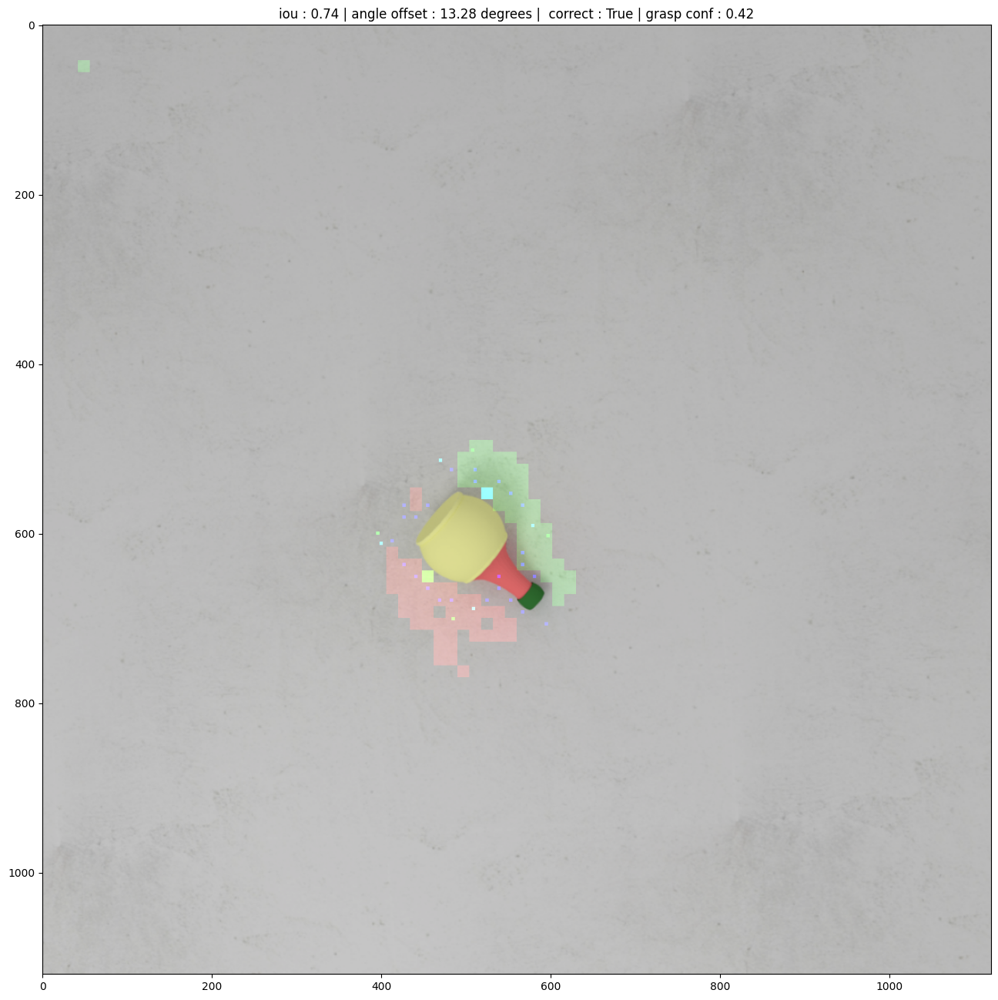

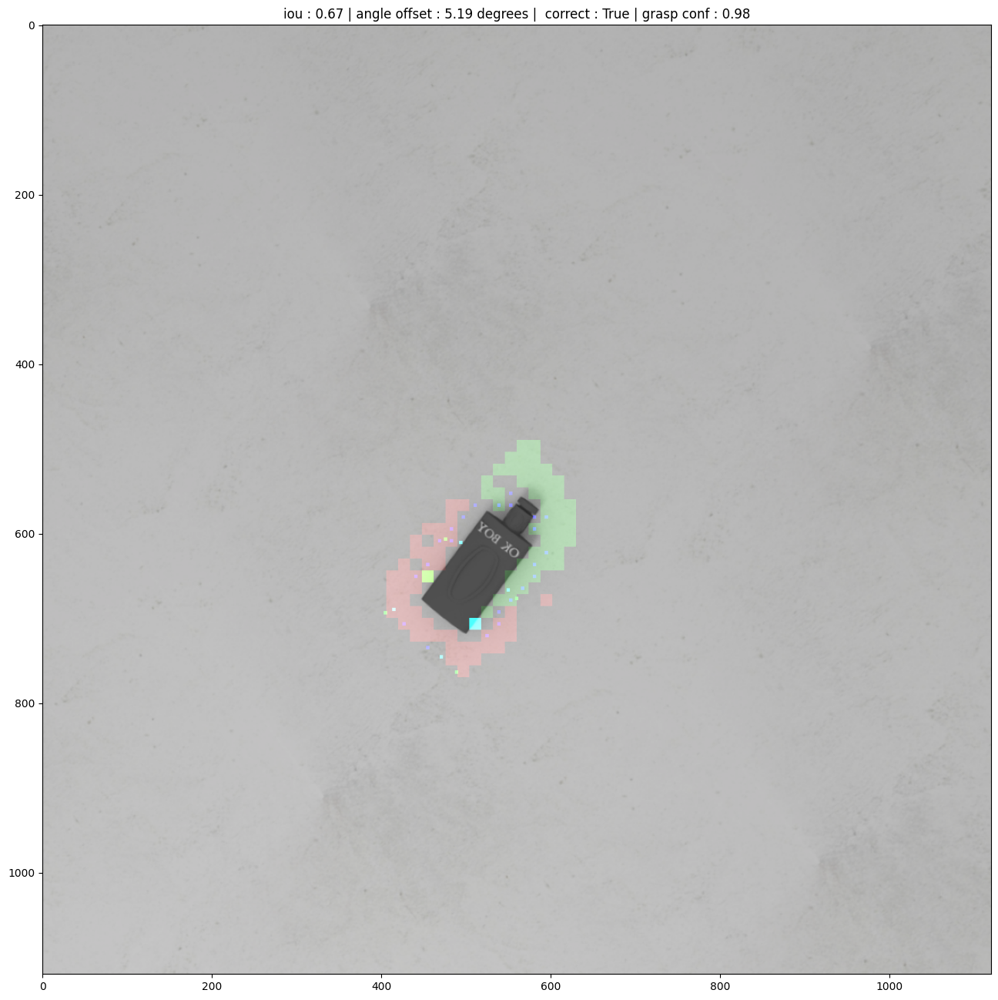

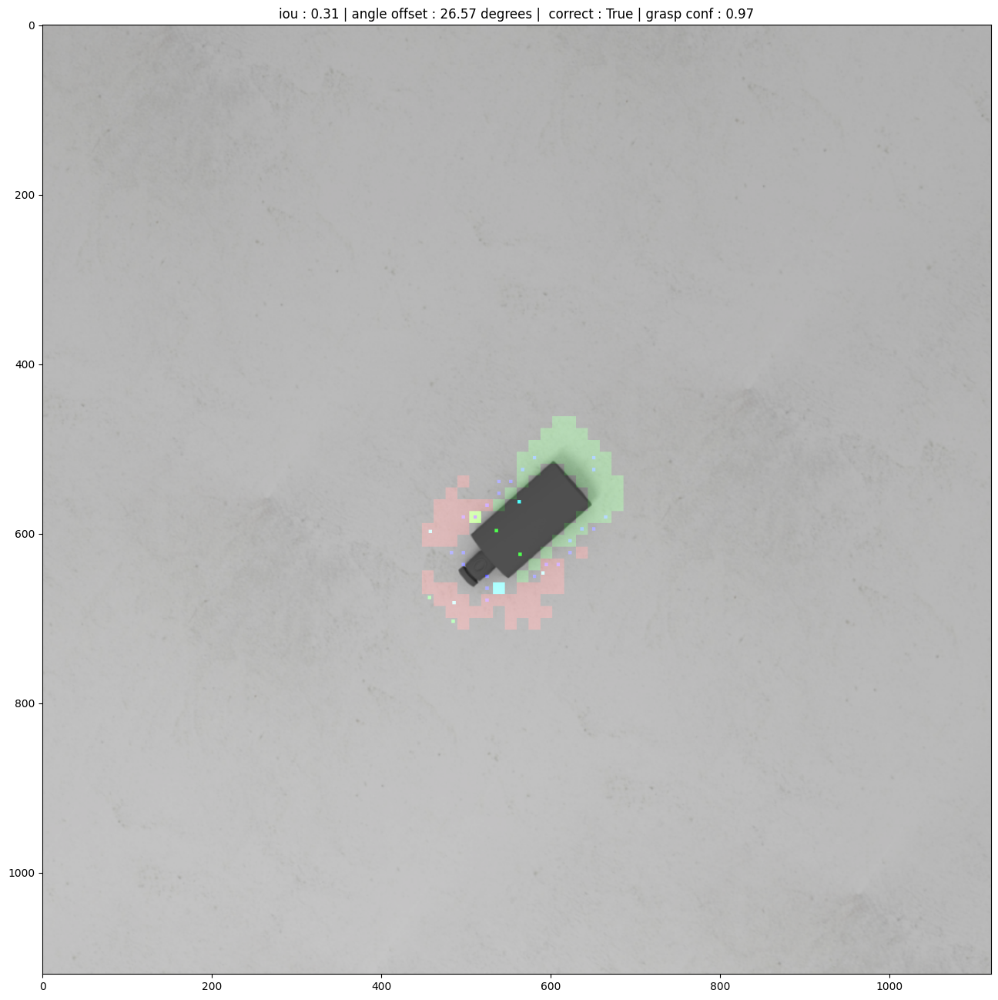

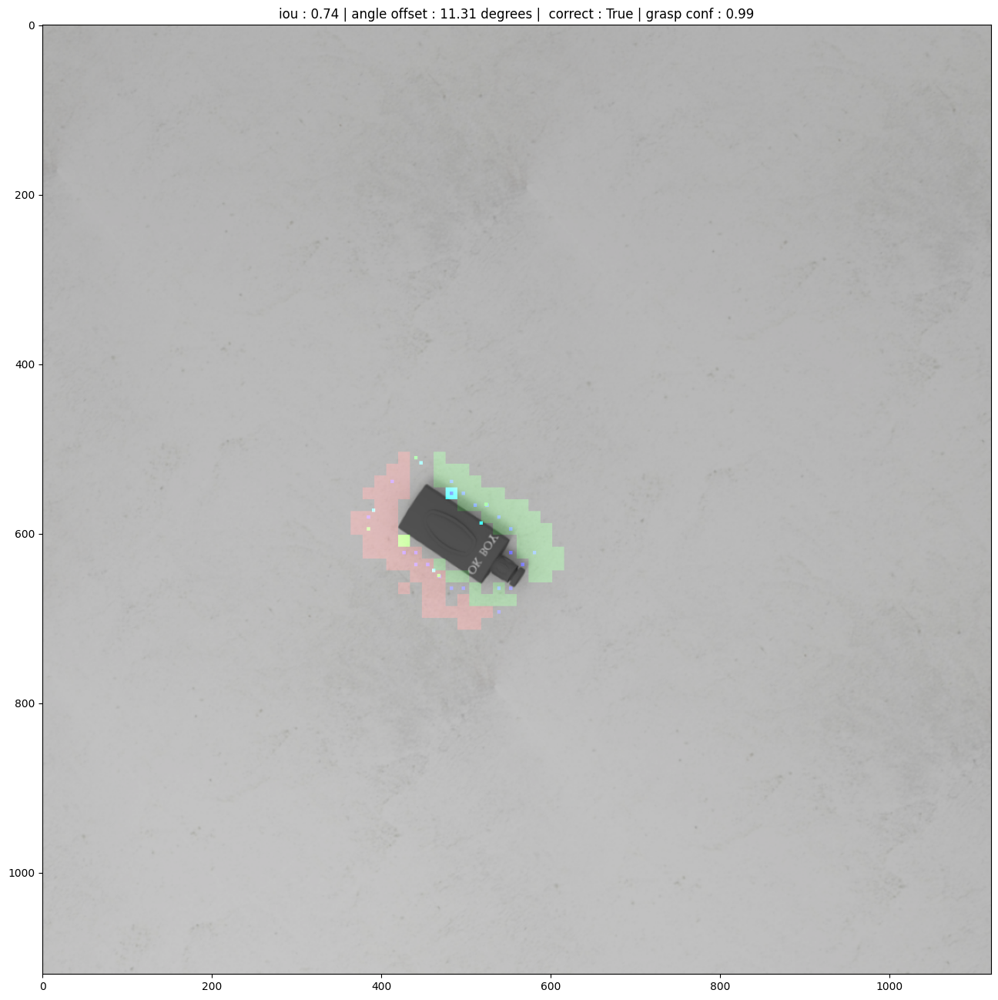

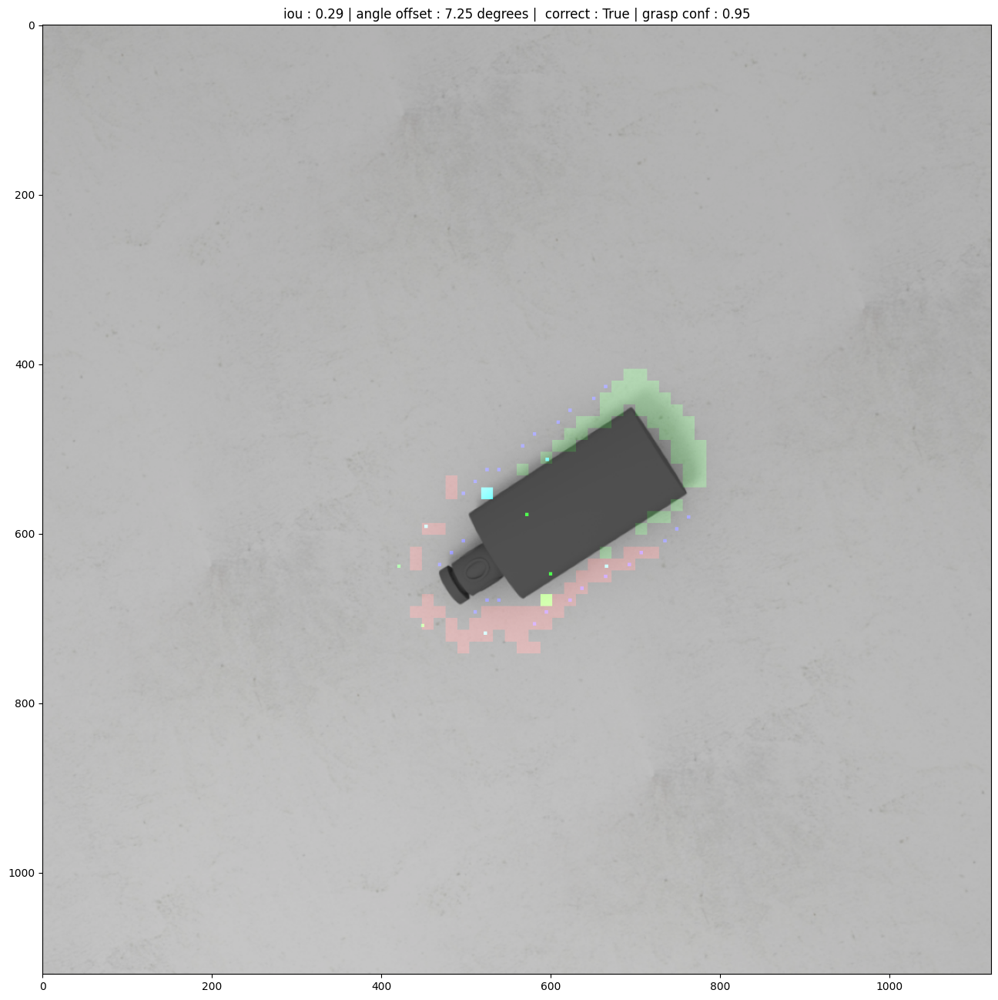

In [28]:
accuracies = []
for test_idx in range(len(dataset)): 
    #test_idx = 13
    data = dataset[test_idx]
    img = data["img"].to(device)
    mask = data["mask"].to(device)
    img = torch.permute(img, (0, 2, 1))
    grasp = data["points_grasp"]//14
    normal_grasp = grasp.clone()
    grasp_inv = torch.cat([grasp[:,1,:].unsqueeze(1), grasp[:,0,:].unsqueeze(1)], dim=1)
    grasp = torch.cat([grasp, grasp_inv], dim=0)
    #get features from dino
    features,_ = model.forward_dino_features(img.unsqueeze(0))
    features = features.squeeze().reshape(PATCH_DIM, PATCH_DIM, 768)

    #plt.figure(figsize=(16,16))
    org_image = torch.permute(inv_transform(img), (1, 2, 0)).cpu().numpy()
    #plt.imshow(org_image)


    ## get valid points
    all_points = torch.tensor([[i,j] for j in range(PATCH_DIM) for i in range(PATCH_DIM)]).unsqueeze(1).to(device)


    #preds, preds_patches = get_valid_points(all_points, features, model, device,PATCH_DIM=PATCH_DIM)
    preds_left, preds_right, pred_patches_left, pred_patches_right = get_valid_points_left_right(all_points, features, model, device,PATCH_DIM=PATCH_DIM)
    
    
    #preds_cp, pts, valid_pts_pred = get_topk_valid_points(preds,preds_patches, mask, topk_num=topk_input,TOP_K=TOPK)
    preds_cp_left, pts_left, valid_pts_pred_left,\
        preds_cp_right, pts_right, valid_pts_pred_right  = get_topk_valid_points_left_right(preds_left, preds_right, pred_patches_left, pred_patches_right, mask, topk_num=topk_input,TOP_K=TOPK)

    #get second point informations 
    mask, mask_n, _, _, grasp, heights, corners = get_second_point_data(dataset,4,model_single,device,args_infer, inv_transform,test_idx=test_idx)

    num_grasps = valid_pts_pred_left.shape[0]
    #objs = 1


    data = {}
    data['mask'] = mask
    data['valid_pts_pred_left'] = valid_pts_pred_left
    data['valid_pts_pred_right'] = valid_pts_pred_right
    data['min_dist'] = min_dist
    data['max_dist'] = max_dist
    data['heights'] = heights 
    data['args_infer'] = args_infer
    data['mask_n'] = mask_n
    data['device'] = device
    data['features'] = features
    data['model_single'] = model_single

    ##currently only support constraint mode == false
    items = get_predictions_left_right(num_grasps,data,constrain_mode=constrain_mode)
    #try:
    cur_accuracy = vis_preds_with_metrics_left_right(num_grasps, items, org_image, grasp,heights, args_infer,preds_cp_left,preds_cp_right,topks=topk_grasps)
    accuracies.append(cur_accuracy)
    #except:
    #    accuracies.append(0.)
    

    print('Object accuracy is', sum(accuracies)/len(accuracies))



In [15]:
print(org_image.shape)

(1120, 1120, 3)


In [20]:
print(torch.unique(preds))

tensor([0.])


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


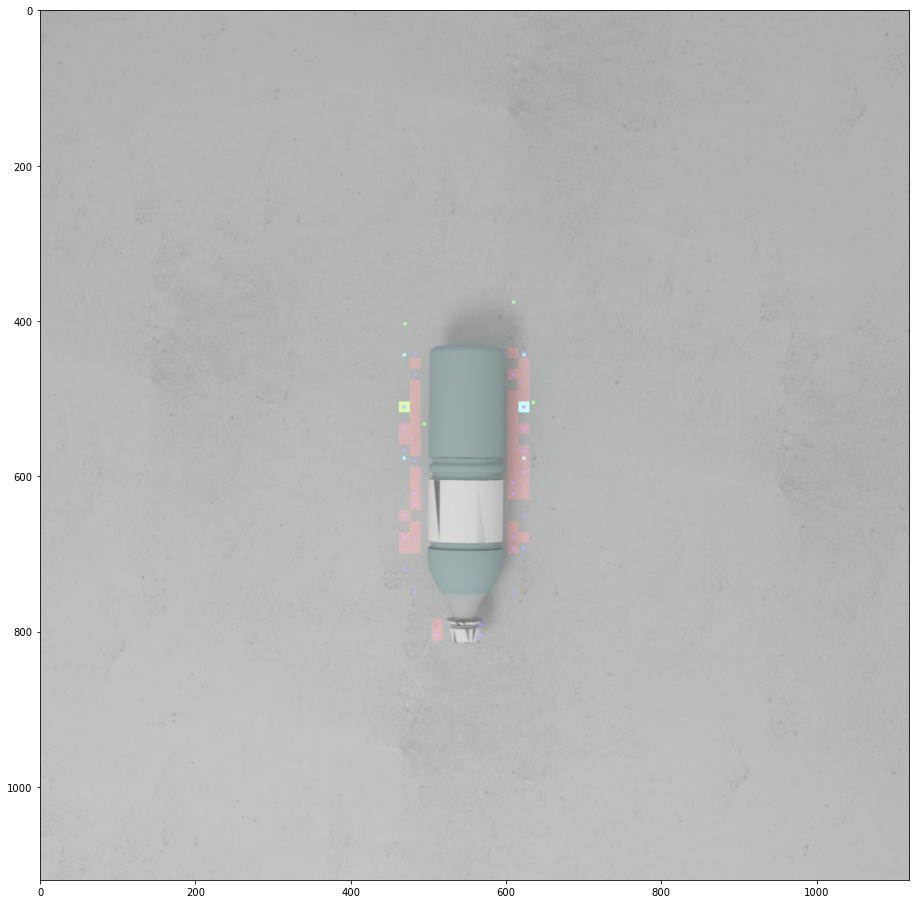

In [22]:
plt.figure(figsize=(16,16))
plt.imshow(org_image + origin_point*0.7)